# Building Segmentation

In [11]:
import glob
import matplotlib.pyplot as plt
import numpy as np
import tifffile as tiff
import cv2

import os

import tensorflow as tf
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras import backend as K
from tensorflow.keras.optimizers import *
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint, Callback
from tensorflow.keras.metrics import MeanIoU, Accuracy

In [12]:
import tensorflow as tf
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    try:
        tf.config.experimental.set_virtual_device_configuration(gpus[0], [tf.config.experimental.VirtualDeviceConfiguration(memory_limit=4096)])
    except RuntimeError as e:
        print(e)

Virtual devices cannot be modified after being initialized


In [13]:
gpus

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU')]

In [14]:
# import numpy as np

# def extract_padded_patches(image, patch_size=(512, 512)):
#     height, width = image.shape[:2]
#     patch_height, patch_width = patch_size

#     num_patches_y = (height + patch_height - 1) // patch_height
#     num_patches_x = (width + patch_width - 1) // patch_width

#     # Calculate padding
#     pad_y = num_patches_y * patch_height - height
#     pad_x = num_patches_x * patch_width - width

#     # Pad the image
#     padded_image = np.pad(image, ((0, pad_y), (0, pad_x), (0, 0)), mode='constant')
#     #print(padded_image.shape)
    
#     # Extract patches
#     patches = []

#     for y in range(0, num_patches_y * patch_height, patch_height):
#         for x in range(0, num_patches_x * patch_width, patch_width):
#             patch = padded_image[y:y+patch_height, x:x+patch_width]
#             #plt.imshow(patch/255)
#             patches.append(patch)

#     return np.array(patches)

# #load the .npz file
# def load_images(path,name, labels):
#     npzfile=np.load(path+"{}.npz".format(name))
#     images=npzfile['arr_0']
#     #patches_image=np.zeros()
#     images =[extract_padded_patches(image, (512, 512)) for image in images]
#     images = [patch for patches in images for patch in patches]


#     npzfile=np.load(path+"{}.npz".format(labels))
#     labels=npzfile['arr_0']
#     #labels=[color.rgb2gray(resize(x,(512,512),mode='constant', preserve_range=True)) for x in labels]
    
#     labels =[extract_padded_patches(image, (512, 512)) for image in labels]
#     labels = [patch for patches in labels for patch in patches]
#     labels = np.array(labels)
#     labels=[cv2.threshold(color.rgb2gray(gt), 128, 1, cv2.THRESH_BINARY)[1] for gt in labels]
    
#     return np.array(images),  np.reshape(np.array(labels), (-1, 512, 512, 1))

In [15]:
# import matplotlib.pyplot as plt

# # Assume 'patches' is a list of images obtained from extract_padded_patches function

# # Create a figure with subplots
# fig, axs = plt.subplots(1, len(patches), figsize=(15, 5))

# # Iterate through patches and display them
# for i, patch in enumerate(patches):
#     axs[i].imshow(patch/255)
#     axs[i].axis('off')
#     axs[i].set_title(f'Patch {i + 1}')

# # Show the plot
# plt.show()


In [16]:
#load the .npz file
def load_images(path, name, labels):
    npzfile=np.load(path+"{}.npz".format(name))
    images=npzfile['arr_0']


    npzfile=np.load(path+"{}.npz".format(labels))
    labels=npzfile['arr_0']

    return images, labels

In [17]:
path='/kaggle/input/building-patches-512/'

x_train,y_train = load_images(path,'x_train_patches','y_train_patches')


x_val,y_val = load_images(path,'x_val_patches','y_val_patches')


x_test,y_test = load_images(path,'x_test_patches','y_test_patches')


x_train.sort()
y_train.sort()

x_val.sort()
y_val.sort()

x_test.sort()
y_test.sort()

print(x_train.shape, y_train.shape, x_test.shape, y_test.shape)

(1233, 512, 512, 3) (1233, 512, 512, 1) (90, 512, 512, 3) (90, 512, 512, 1)


In [18]:
from tensorflow.keras.utils import Sequence
import numpy as np 
class DataGenerator(Sequence):
    def __init__(self, x_set, y_set, batch_size):
        self.x, self.y = x_set, y_set
        self.batch_size = batch_size

    def __len__(self):
        return int(np.ceil(len(self.x) / float(self.batch_size)))

    def __getitem__(self, idx):
        batch_x = self.x[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_y = self.y[idx * self.batch_size:(idx + 1) * self.batch_size]
        return batch_x, batch_y

train_gen = DataGenerator(x_train, y_train, 16)
val_gen = DataGenerator(x_val, y_val, 16)


Text(0.5, 1.0, 'Actual image')

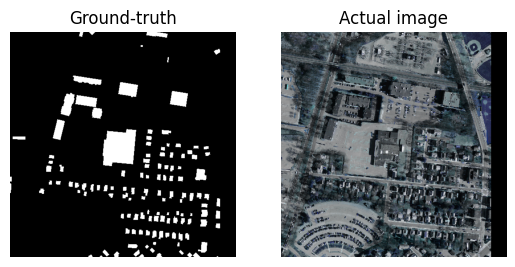

In [19]:
import matplotlib.pyplot as plt
fig = plt.figure()
fig.figsize = (30,30)

ax = fig.add_subplot(1,2,1)
ax.imshow(np.reshape(y_train[2]/255,(512,512)),cmap="gray")
plt.axis('off')
plt.title("Ground-truth")

ax = fig.add_subplot(1,2,2)
ax.imshow(x_train[2]/255)
plt.axis('off')
plt.title("Actual image")

# Loss

In [20]:
from keras import backend as K
from keras.losses import binary_crossentropy
import tensorflow as tf

def dice_coef(y_true, y_pred, smooth=1):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def iou_coef(y_true, y_pred, smooth=1):
    intersection = K.sum(K.abs(y_true * y_pred), axis=[1,2,3])
    union = K.sum(y_true,[1,2,3])+K.sum(y_pred,[1,2,3])-intersection
    iou = K.mean((intersection + smooth) / (union + smooth), axis=0)
    return iou

def dice_loss(y_true, y_pred):
    smooth = 1.
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)
    intersection = y_true_f * y_pred_f
    score = (2. * K.sum(intersection) + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)
    return 1. - score

def bce_dice_loss(y_true, y_pred):
    return binary_crossentropy(tf.cast(y_true, tf.float32), y_pred) + 0.5 * dice_loss(tf.cast(y_true, tf.float32), y_pred)

In [21]:
import tensorflow as tf

def create_callbacks():
    # Reduce learning rate on plateau
    reduce_lr = tf.keras.callbacks.ReduceLROnPlateau(
        monitor='val_loss',
        mode='min',
        factor=0.5,
        patience=10,
        verbose=1,
        cooldown=1,
        min_delta=0.0001
    )

    # Early stopping
    early_stop = tf.keras.callbacks.EarlyStopping(
        monitor='val_accuracy',
        min_delta=0.0001,
        patience=30,
        verbose=1,
        mode='max',
        restore_best_weights=True
    )

    # Model checkpoint
    # Define the path using os.path.join for cross-platform compatibility
    check_path = os.path.join('.', 'macunet_building.weights.h5')
    checkpoint = tf.keras.callbacks.ModelCheckpoint(
        check_path,
        monitor='val_loss',
        verbose=1,
        save_best_only=True,
        save_weights_only=True,
        mode='min'
    )

    return [reduce_lr, early_stop, checkpoint]

# Usage example:


In [22]:
import matplotlib.pyplot as plt

def plot_history(history):
    # Accuracy plot
    plt.plot(history.history['accuracy'], label='train_acc')
    plt.plot(history.history['val_accuracy'], '--', label='val_acc')
    plt.legend()
    plt.xlabel("No. of epochs")
    plt.ylabel("Accuracy")
    plt.title("Training and Validation Accuracy")
    plt.show()

    # Loss plot
    plt.plot(history.history['loss'], label='train_loss')
    plt.plot(history.history['val_loss'], '--', label='val_loss')
    plt.legend()
    plt.xlabel("No. of epochs")
    plt.ylabel("Loss")
    plt.title("Training and Validation Loss")
    plt.show()



In [23]:
import numpy as np
from sklearn.metrics import confusion_matrix, classification_report, cohen_kappa_score, precision_score, recall_score

def get_dice(y_true, y_pred):
    intersection = np.sum(y_true * y_pred, axis=(0, 1, 2))
    union = np.sum(y_true**2, axis=(0, 1, 2)) + np.sum(y_pred**2, axis=(0, 1, 2))
    dc = 2 * intersection / union
    return dc


def evaluate_segmentation(y_test, y_pred):
    # Mean Intersection over Union
    mean_iou = MeanIoU(2)
    mean_iou.update_state(y_test, y_pred)
    class_iou = mean_iou.result().numpy()
    mean_iou.reset_states()
    
    # Accuracy
    acc = Accuracy()
    acc.update_state(y_test, y_pred)
    accuracy = acc.result().numpy()
    acc.reset_states()
    
    # Precision
    precision = precision_score(y_test.ravel(), y_pred.ravel(), average='binary')
    
    # Recall
    recall = recall_score(y_test.ravel(), y_pred.ravel(), average='binary')
    
    # Confusion Matrix
    cm = confusion_matrix(y_test.ravel(), y_pred.ravel())
    
    # Classification Report
    cr = classification_report(y_test.ravel(), y_pred.ravel())
    
    # Cohen's Kappa Score
    kappa = cohen_kappa_score(y_test.ravel(), y_pred.ravel())
    
    # Dice Coefficient
    dice_coeff = get_dice(y_test, y_pred)
    mean_dice_coeff = np.mean(dice_coeff)
    
    return {
        "mean_iou": mean_iou,
        "class_iou": class_iou,
        "accuracy": accuracy,
        "precision": precision,
        "recall": recall,
        "confusion_matrix": cm,
        "classification_report": cr,
        "cohen_kappa_score": kappa,
        "dice_coefficient": dice_coeff,
        "mean_dice_coefficient": mean_dice_coeff
    }


In [24]:
import matplotlib.pyplot as plt

def visualize_predictions(x_test, y_test, y_pred, num_samples=10):
    fig = plt.figure(figsize=(100, 100))

    for i in range(num_samples):
        # Plot input image
        ax = fig.add_subplot(num_samples, 3, 3*i+1)
        ax.imshow(np.reshape(x_test[i]/255, (512, 512,3)))
        plt.axis('off')
        plt.title("Input image")

        # Plot ground truth
        ax = fig.add_subplot(num_samples, 3, 3*i+2)
        ax.imshow(np.reshape(y_test[i], (512, 512)), cmap="gray")
        plt.axis('off')
        plt.title("Ground-truth")

        # Plot predicted image
        ax = fig.add_subplot(num_samples, 3, 3*i+3)
        ax.imshow(np.reshape(y_pred[i], (512, 512)), cmap="gray")
        plt.axis('off')
        plt.title("Predicted image")

    plt.tight_layout(pad=0)
    plt.show()

# **MACU Net**

In [25]:
import tensorflow as tf                                                                                                                                                   

In [2]:
# Define the Channel Attention module
class ChannelAttention(tf.keras.layers.Layer):
    def __init__(self, out_planes, ratio=2):
        super(ChannelAttention, self).__init__()
        self.conv = tf.keras.layers.Conv2D(out_planes, 1, padding='same', use_bias=False)
        self.avg_pool = tf.keras.layers.GlobalAveragePooling2D()
        self.max_pool = tf.keras.layers.GlobalMaxPooling2D()
        self.fc11 = tf.keras.layers.Conv2D(out_planes // ratio, 1, padding='same', use_bias=False)
        self.fc12 = tf.keras.layers.Conv2D(out_planes, 1, padding='same', use_bias=False)
        self.fc21 = tf.keras.layers.Conv2D(out_planes // ratio, 1, padding='same', use_bias=False)
        self.fc22 = tf.keras.layers.Conv2D(out_planes, 1, padding='same', use_bias=False)
        self.relu1 = tf.keras.layers.ReLU()
        self.sigmoid = tf.keras.layers.Activation('sigmoid')
        self.reshape= tf.keras.layers.Reshape((1, 1, -1))

    def call(self, x):
        #print('input to attention', x.shape)
        x = self.conv(x)
        #print('chA conv1 ', x.shape)
        # x=self.avg_pool(x)
        # print('chA avgpool ', x.shape)
        # x = tf.keras.layers.Reshape((1, 1, -1))(x)
        # x=self.fc11(x)
        # print('chA fc11 ', x.shape)
        # x=self.relu1(x)
        # print('chA relu1 ', x.shape)
        # x=self.fc12(x)
        # print('chA fc12 ', x.shape)
        
        avg_out = self.fc12(self.relu1(self.fc11(self.reshape(self.avg_pool(x)))))
        max_out = self.fc22(self.relu1(self.fc21(self.reshape(self.max_pool(x)))))
        out = avg_out + max_out
        return x * self.sigmoid(out)

In [3]:
def conv3otherRelu(filters, kernel_size=None, stride=None, padding=None):
    if kernel_size is None:
        kernel_size = 3
    if stride is None:
        stride = 1
    if padding is None:
        padding = 'same'

    return tf.keras.Sequential([
        tf.keras.layers.Conv2D(filters, kernel_size, stride, padding, use_bias=True),
        tf.keras.layers.LeakyReLU()
    ])

In [4]:
# Define the ACBlock module
class ACBlock(tf.keras.layers.Layer):
    def __init__(self, out_planes):
        super(ACBlock, self).__init__()
        self.squre = tf.keras.layers.Conv2D(out_planes, 3, padding='same', use_bias=False)
        self.cross_ver = tf.keras.layers.Conv2D(out_planes, (1, 3), padding='same', use_bias=False)
        self.cross_hor = tf.keras.layers.Conv2D(out_planes, (3, 1), padding='same', use_bias=False)
        self.bn = tf.keras.layers.BatchNormalization()
        self.relu = tf.keras.layers.ReLU()

    def call(self, x):
        #print('ACBlock output shape', x.shape)
        x1 = self.squre(x)
        x2 = self.cross_ver(x)
        x3 = self.cross_hor(x)
        #print('ACBlock output shape', self.relu(self.bn(x1 + x2 + x3)).shape)
        return self.relu(self.bn(x1 + x2 + x3))

In [5]:
class MACUNet(tf.keras.Model):
    def __init__(self, band_num, class_num):
        super(MACUNet, self).__init__()
        self.band_num = band_num
        self.class_num = class_num

        # channels = [32, 64, 128, 256, 512]
        channels = [16, 32, 64, 128, 256, 512]
        self.conv1 = tf.keras.Sequential(
           [ ACBlock(channels[0]),
            ACBlock(channels[0])]
        )
        self.conv12 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[1])]
        )
        self.conv13 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[2])]
        )
        self.conv14 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[3])]
        )

        self.conv2 = tf.keras.Sequential(
           [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[1]),
            ACBlock(channels[1])]
        )
        self.conv23 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[2])]
        )
        self.conv24 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[3])]
        )

        self.conv3 = tf.keras.Sequential(
           [ tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[2]),
            ACBlock(channels[2]),
            ACBlock(channels[2])]
        )
        self.conv34 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[3])]
        )

        self.conv4 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[3]),
            ACBlock(channels[3]),
            ACBlock(channels[3])]
        )

        self.conv5 = tf.keras.Sequential(
            [tf.keras.layers.MaxPooling2D(pool_size=(2, 2), strides=(2, 2)),
            ACBlock(channels[4]),
            ACBlock(channels[4]),
            ACBlock(channels[4])]
        )

        self.skblock4 = ChannelAttention(channels[3]*2, 16)
        self.skblock3 = ChannelAttention(channels[2]*2, 16)
        self.skblock2 = ChannelAttention(channels[1]*2, 16)
        self.skblock1 = ChannelAttention(channels[0]*2, 16)

        self.deconv4 = tf.keras.layers.Conv2DTranspose(channels[3], kernel_size=2, strides=(2, 2))
        self.deconv43 = tf.keras.layers.Conv2DTranspose(channels[2], kernel_size=2, strides=(2, 2))
        self.deconv42 = tf.keras.layers.Conv2DTranspose(channels[1], kernel_size=2, strides=(2, 2))
        self.deconv41 = tf.keras.layers.Conv2DTranspose(channels[0], kernel_size=2, strides=(2, 2))


        self.conv6 = tf.keras.Sequential(
           [ ACBlock( channels[3]),
            ACBlock(channels[3])]
        )

        self.deconv3 = tf.keras.layers.Conv2DTranspose(channels[2], kernel_size=2, strides=(2, 2))
        self.deconv32 = tf.keras.layers.Conv2DTranspose(channels[1], kernel_size=2, strides=(2, 2))
        self.deconv31 = tf.keras.layers.Conv2DTranspose(channels[0], kernel_size=2, strides=(2, 2))
        self.conv7 = tf.keras.Sequential(
            [ACBlock(channels[2]),
            ACBlock(channels[2])]
        )

        self.deconv2 = tf.keras.layers.Conv2DTranspose(channels[1], kernel_size=2, strides=(2, 2))
        self.deconv21 = tf.keras.layers.Conv2DTranspose(channels[0], kernel_size=2, strides=(2, 2))
        self.conv8 = tf.keras.Sequential(
            [ACBlock(channels[1]),
            ACBlock(channels[1])]
        )

        self.deconv1 = tf.keras.layers.Conv2DTranspose(channels[0], kernel_size=2, strides=(2, 2))
        self.conv9 = tf.keras.Sequential(
            [ACBlock(channels[0]),
            ACBlock(channels[0])]
        )

        self.conv10 = tf.keras.layers.Conv2D(self.class_num, kernel_size=1, strides=1)

    def call(self, x):
        #print('input shape', x.shape)
        conv1 = self.conv1(x)
        #print('conv1 shape', conv1.shape)
        conv12 = self.conv12(conv1)
        #print('conv12 shape', conv12.shape)
        conv13 = self.conv13(conv12)
        #print('conv13 shape', conv13.shape)
        conv14 = self.conv14(conv13)
        #print('conv14 shape', conv14.shape)


        conv2 = self.conv2(conv1)
        #print('conv2 shape', conv2.shape)
        conv23 = self.conv23(conv2)
        #print('conv23 shape', conv23.shape)
        conv24 = self.conv24(conv23)
        #print('conv24 shape', conv24.shape)

        conv3 = self.conv3(conv2)
        #print('conv3 shape', conv3.shape)
        conv34 = self.conv34(conv3)
        #print('conv34 shape', conv34.shape)
        conv4 = self.conv4(conv3)
        #print('conv4 shape', conv4.shape)
        conv5 = self.conv5(conv4)
        #print('conv5 shape', conv5.shape)
        
        deconv4 = self.deconv4(conv5)
        #print('deconv4 shape', deconv4.shape)
        deconv43 = self.deconv43(deconv4)
        #print('deconv43 shape', deconv43.shape)
        deconv42 = self.deconv42(deconv43)
        #print('deconv42 shape', deconv42.shape)
        deconv41 = self.deconv41(deconv42)
        #print('deconv41 shape', deconv41.shape)

        conv6 = tf.concat([deconv4, conv4, conv34, conv24, conv14], axis=-1)
        #print('conv6 concat shape', conv6.shape)
        conv6 = self.skblock4(conv6)
        #print('conv6 attention shape', conv6.shape)
        conv6 = self.conv6(conv6)
        del deconv4, conv4, conv34, conv24, conv14, conv5

        deconv3 = self.deconv3(conv6)
        deconv32 = self.deconv32(deconv3)
        deconv31 = self.deconv31(deconv32)

        conv7 = tf.concat([deconv3, deconv43, conv3, conv23, conv13], axis=-1)
        conv7 = self.skblock3(conv7)
        conv7 = self.conv7(conv7)
        del deconv3, deconv43, conv3, conv23, conv13, conv6

        deconv2 = self.deconv2(conv7)
        deconv21 = self.deconv21(deconv2)

        conv8 = tf.concat([deconv2, deconv42, deconv32, conv2, conv12], axis=-1)
        conv8 = self.skblock2(conv8)
        conv8 = self.conv8(conv8)
        del deconv2, deconv42, deconv32, conv2, conv12, conv7

        deconv1 = self.deconv1(conv8)
        conv9 = tf.concat([deconv1, deconv41, deconv31, deconv21, conv1], axis=-1)
        conv9 = self.skblock1(conv9)
        conv9 = self.conv9(conv9)
        # conv9 = self.seblock(conv9)
        del deconv1, deconv41, deconv31, deconv21, conv1, conv8

        output = self.conv10(conv9)
        #print('output shape', output.shape)
            
        return output

In [8]:
import tensorflow as tf

# Define the input layer
inputs = tf.keras.layers.Input((512, 512, 3))

# Create an instance of your MACUNet model
macu_net = MACUNet(3, 1)

# Call the MACUNet model on the input tensor to get the output tensor
outputs = macu_net(inputs)

# Define the model with input and output tensors
model = tf.keras.Model(inputs, outputs)

# Display the model summary
model.summary()

#out = model(x)


output shape (None, 512, 512, 1)
output shape (None, 512, 512, 1)


Model: "functional_16"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_2 (InputLayer)      │ (None, 512, 512, 3)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ macu_net_2 (MACUNet)            │ (None, 512, 512, 1)    │     5,149,185 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 5,149,185 (19.64 MB)

 Trainable params: 5,144,257 (19.62 MB)

 Non-trainable params: 4,928 (19.25 KB)

In [ ]:
model.summary()

In [ ]:
from tensorflow.keras.losses import binary_crossentropy

def dice_loss(y_true, y_pred):
    smooth = 1
    intersection = tf.reduce_sum(y_true * y_pred)
    return 1 - (2. * intersection + smooth) / (tf.reduce_sum(y_true) + tf.reduce_sum(y_pred) + smooth)


In [9]:
opt = tf.keras.optimizers.Adam(learning_rate=(1e-4)*3)
model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy'])

In [26]:
callbacks = create_callbacks()
history = model.fit(train_gen, validation_data=val_gen, batch_size=16,shuffle=True, verbose=1
                                  ,epochs = 100, callbacks = callbacks )


Epoch 1/100
output shape (None, 512, 512, 1)
output shape (None, 512, 512, 1)


/opt/conda/lib/python3.10/site-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:122: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()
2024-03-12 06:58:14.077343: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[32,64,3,3]{3,2,1,0}, u8[0]{0}) custom-call(f32[16,64,256,256]{3,2,1,0}, f32[16,32,256,256]{3,2,1,0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBackwardFilter", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-12 06:58:14.195991: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.118818179s
Trying algorithm eng0{} for conv (f32[32,6

78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.4407 - loss: 5.2196output shape (None, 512, 512, 1)

Epoch 1: val_loss improved from inf to 13.54832, saving model to ./macunet_building.weights.h5
78/78 ━━━━━━━━━━━━━━━━━━━━ 461s 3s/step - accuracy: 0.4423 - loss: 5.2007 - val_accuracy: 0.1289 - val_loss: 13.5483 - learning_rate: 3.0000e-04
Epoch 2/100
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.7988 - loss: 1.4282
Epoch 2: val_loss improved from 13.54832 to 6.56828, saving model to ./macunet_building.weights.h5
78/78 ━━━━━━━━━━━━━━━━━━━━ 123s 2s/step - accuracy: 0.7991 - loss: 1.4244 - val_accuracy: 0.5646 - val_loss: 6.5683 - learning_rate: 3.0000e-04
Epoch 3/100
78/78 ━━━━━━━━━━━━━━━━━━━━ 0s 2s/step - accuracy: 0.8619 - loss: 0.7053
Epoch 3: val_loss improved from 6.56828 to 0.57760, saving model to ./macunet_building.weights.h5
78/78 ━━━━━━━━━━━━━━━━━━━━ 123s 2s/step - accuracy: 0.8618 - loss: 0.7044 - val_accuracy: 0.8884 - val_loss: 0.5776 - learning_rate: 3.0000e-04
Ep

In [ ]:
plot_history(history)

In [ ]:
edgeNetModel.load_weights("C:\\Users\\shyamlal\\Documents\\Building_Road_Segm\\macunet_building.weights.h5")

In [27]:
y_pred = model.predict(x_test)
y_pred = y_pred>0.5

output shape (32, 512, 512, 1)


2024-03-12 10:31:10.789051: E external/local_xla/xla/service/slow_operation_alarm.cc:65] Trying algorithm eng0{} for conv (f32[32,32,512,512]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,80,512,512]{3,2,1,0}, f32[32,80,1,1]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convForward", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-12 10:31:11.470376: E external/local_xla/xla/service/slow_operation_alarm.cc:133] The operation took 1.681430131s
Trying algorithm eng0{} for conv (f32[32,32,512,512]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,80,512,512]{3,2,1,0}, f32[32,80,1,1]{3,2,1,0}), window={size=1x1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convForward", backend_config={"conv_result_scale":1,"activation_mode":"kNone","side_input_scale":0,"leakyrelu_alpha":0} is taking a while...
2024-03-12 10:31:15.964704: E external/local_xla/xla/service/slow_operation_a

3/3 ━━━━━━━━━━━━━━━━━━━━ 251s 57s/step


In [ ]:
#y_pred[1]>0.5

In [28]:
visualize_predictions(x_test, y_test, y_pred, num_samples=9)

In [29]:
from sklearn.metrics import *
gt=(y_test.ravel()).astype('int')
pd=(np.array(y_pred).ravel()).astype('int')
f1 = f1_score(gt,pd,average='macro')
kappa = cohen_kappa_score(gt,pd)
accuracy = accuracy_score(gt,pd)
jaccard = jaccard_score(gt,pd,average='macro')
precision = precision_score(gt,pd,average='macro')
recall = recall_score(gt,pd,average='macro')
#print(np.unique(gt),np.unique(pd))
print("F1 SCORE:", f1)
print("Kappa:",kappa)
print("Accuracy:",accuracy)
print("Jaccard Score:",jaccard)
print("Precision:",precision)
print("Recall:",recall)


F1 SCORE: 0.8245848750022803
Kappa: 0.6503882317834174
Accuracy: 0.9076051500108507
Jaccard Score: 0.7196528251192631
Precision: 0.8689013057553159
Recall: 0.7944034038936787


In [30]:
def get_dice(y_true, y_pred):

    intersection = np.sum(y_true * y_pred, axis=(0, 1, 2))
    union = np.sum(y_true**2, axis=(0, 1, 2)) + np.sum(y_pred**2, axis=(0, 1, 2))
    dc = 2 * intersection / union
    return dc

dice_coeff = get_dice(y_test, y_pred)
print("dc = ",np.mean(dice_coeff))

dc =  0.7039075701020902


# **CTMU_Net**

In [ ]:
import tensorflow as tf
class LipPooling(tf.keras.layers.Layer):
    def __init__(self, filters=1):
        super(LipPooling, self).__init__()
        self.conv1=tf.keras.layers.Conv2D(filters, 3, padding='valid')
        self.batch_norm=tf.keras.layers.BatchNormalization()
        self.window_size=(3,3)
    def call(inputs):
        x=self.conv1(inputs)
        x=self.batch_norm(x)
        x=tf.keras.activations.sigmoid(x)
        e_x=tf.keras.activations.exponential(x)
        m_x= inputs*e_x
        e_x=tf.nn.pool(e_x, self.window_size, pooling_type='SUM', padding='VALID')
        m_x=tf.nn.pool(m_x, self.window_size, pooling_type='SUM', padding='VALID')
        x=tf.divide(m_x, e_x+1e-8)

        return x      

In [ ]:
def channel_attention(input_feature, ratio=8):
	
	channel_axis = -1
	channel = input_feature._keras_shape[channel_axis]
	
	shared_layer_one = Dense(channel//ratio,
							 activation='relu',
							 kernel_initializer='he_normal',
							 use_bias=True,
							 bias_initializer='zeros')
	shared_layer_two = Dense(channel,
							 kernel_initializer='he_normal',
							 use_bias=True,
							 bias_initializer='zeros')
	
	avg_pool = GlobalAveragePooling2D()(input_feature)    
	avg_pool = Reshape((1,1,channel))(avg_pool)
	assert avg_pool._keras_shape[1:] == (1,1,channel)
	avg_pool = shared_layer_one(avg_pool)
	assert avg_pool._keras_shape[1:] == (1,1,channel//ratio)
	avg_pool = shared_layer_two(avg_pool)
	assert avg_pool._keras_shape[1:] == (1,1,channel)
	
	max_pool = GlobalMaxPooling2D()(input_feature)
	max_pool = Reshape((1,1,channel))(max_pool)
	assert max_pool._keras_shape[1:] == (1,1,channel)
	max_pool = shared_layer_one(max_pool)
	assert max_pool._keras_shape[1:] == (1,1,channel//ratio)
	max_pool = shared_layer_two(max_pool)
	assert max_pool._keras_shape[1:] == (1,1,channel)
	
	cbam_feature = Add()([avg_pool,max_pool])
	cbam_feature = Activation('sigmoid')(cbam_feature)
	
	# if K.image_data_format() == "channels_first":
	# 	cbam_feature = Permute((3, 1, 2))(cbam_feature)
	
	return multiply([input_feature, cbam_feature])

In [ ]:
#CTM module

import tensorflow as tf

def get_row_attention(q, k, f):
  """
  Calculates row attention based on Q, K, and F feature maps.

  Args:
    q: A tensor of shape (batch_size, height, width, reduced_channels).
    k: A tensor of the same shape as q.
    f: A tensor of shape (batch_size, height, width, channels).

  Returns:
    A tensor of shape (batch_size, height, width, channels).
  """
  
  # Get dimensions
  batch_size, height, width, reduced_channels = q.shape
  channels = f.shape[-1]

  # Calculate correlations
  correlations = tf.matmul(q, tf.transpose(k))  # (batch_size, H, W, H)
  correlations = tf.nn.softmax(correlations, axis=-1)  # (batch_size, H, W, H)

  # Generate V feature map
  v = tf.keras.layers.Conv2D(channels, kernel_size=1, activation=None, padding='same')(f)

  # Calculate row attention scores
  row_attention = []
  for i in range(height):
    # Extract relevant feature vectors for row i
    qi = q[:, i, :, :]  # (batch_size, 1, W, reduced_channels)
    ki = k[:, i, :, :]  # (batch_size, W, reduced_channels)
    vi = v[:, i, :, :]  # (batch_size, 1, W, channels)
    phi_i = k[:, :, i, :]  # (batch_size, W, channels)

    # Calculate attention for row i
    row_i_attention = tf.reduce_sum(correlations[:, i, :, :] * phi_i, axis=1) + vi
    row_attention.append(row_i_attention)
  row_attention = tf.stack(row_attention, axis=1)  # (batch_size, H, W, channels)

  return row_attention

# # Example usage (assuming Q, K, and F are defined elsewhere)
# row_attention = get_row_attention(q, k, f)
# print(f"Row attention shape: {row_attention.shape}")


In [ ]:
import tensorflow as tf

def get_column_attention(yrow, q, k, f):
  """
  Calculates column attention based on Yrow, Q, K, and F feature maps.

  Args:
    yrow: A tensor of shape (batch_size, height, width, channels).
    q: A tensor of the same shape as yrow.
    k: A tensor of the same shape as q.
    f: A tensor of shape (batch_size, height, width, channels).

  Returns:
    A tensor of shape (batch_size, height, width, channels).
  """
  
  # Get dimensions
  batch_size, height, width, channels = yrow.shape

  # Calculate correlations
  correlations = tf.matmul(yrow, tf.transpose(k, perm=[0, 2, 1, 3]))  # (batch_size, H, W, C)
  correlations = tf.nn.softmax(correlations, axis=-1)  # (batch_size, H, W, C)

  # Calculate column attention scores
  column_attention = []
  for i in range(width):
    # Extract relevant feature vectors for column i
    yrow_i = yrow[:, :, i, :]  # (batch_size, H, 1, channels)
    ki = k[:, :, i, :]  # (batch_size, H, channels)
    fi = f[:, :, i, :]  # (batch_size, H, 1, channels)
    phi_col_i = k[:, :, :, i]  # (batch_size, H, channels)

    # Calculate attention for column i
    col_i_attention = tf.reduce_sum(correlations[:, :, i, :] * phi_col_i, axis=-1) + fi
    column_attention.append(col_i_attention)
  column_attention = tf.stack(column_attention, axis=2)  # (batch_size, H, W, channels)

  return column_attention

# # Example usage (assuming Yrow, Q, K, and F are defined elsewhere)
# column_attention = get_column_attention(yrow, q, k, f)
# print(f"Column attention shape: {column_attention.shape}")


In [ ]:
input_shape = (4, 512, 512, 3)
inputs= tf.keras.Input(shape=(512, 512, 3))
# row attention
x=tf.keras.layers.Conv2D(16,1, activation='relu', padding='same',input_shape=input_shape[1:])(inputs)

q=tf.keras.layers.Conv2D(16,1, activation='relu', padding='same')(x)
k=q
f=x
yrow= get_row_attention(q,k,f)
# column attention
q=tf.keras.layers.Conv2D(512,1, activation='relu', padding='same')(yrow)
k=q
f=yrow
output= get_column_attention(yrow,q,k,f)

model=tf.keras.Model(inputs=inputs, outputs=output)

model.summary()

In [ ]:
?tf.keras.layers.Conv2D

In [ ]:
def extract_patches(feature_map, patch_size=4):
    patches=tf.image.extract_patches(images=feature_map, 
                                     sizes=[1, patch_size, patch_size,1],
                                     strides=[1, patch_size, patch_size,1],
                                    padding='VALID')
    return patches

In [ ]:
model=DPM_UNet((512,512,3))

In [ ]:
model.summary()

In [ ]:
opt = Adam(learning_rate=0.001)
model.compile(optimizer=opt, loss='binary_crossentropy', metrics=['accuracy', iou_coef])

In [ ]:
callbacks = create_callbacks()
history = model.fit(train_gen, validation_data=val_gen, batch_size=4,shuffle=True, verbose=1
                                  ,epochs = 100, callbacks = callbacks )


In [ ]:
plot_history(history)

In [ ]:
y_pred = dppnetmodel.predict(x_test)
y_pred = y_pred>0.5

In [ ]:
visualize_predictions(x_test, y_test, y_pred, num_samples=9)

In [ ]:
model.load_weights('C:\\Users\\Admin\\Documents\\road_segmentation\\dpp_ROAD.h5')

In [ ]:
y_predicted=[]
for i in range(len(x_test)):
    image= np.expand_dims(x_test[i], axis=0)

    y_pred = dppnetmodel.predict(image)
    y_pred=y_pred>0.5
    y_predicted.append(y_pred)



In [ ]:
from sklearn.metrics import *
gt=(y_test.ravel()).astype('int')
pd=(np.array(y_predicted).ravel()).astype('int')
f1 = f1_score(gt,pd,average='macro')
kappa = cohen_kappa_score(gt,pd)
accuracy = accuracy_score(gt,pd)
jaccard = jaccard_score(gt,pd,average='macro')
precision = precision_score(gt,pd,average='macro')
recall = recall_score(gt,pd,average='macro')
print(np.unique(gt),np.unique(pd))
print("F1 SCORE:", f1)
print("Kappa:",kappa)
print("Accuracy:",accuracy)
print("Jaccard Score:",jaccard)
print("Precision:",precision)
print("Recall:",recall)
